# Installation von detectron2 und wichtiger Pakete

In [1]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 7.1 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
Cloning into 'detectron2'...
remote: Enumerating objects: 15837, done.
remote: Counting objects: 100% (65/65), done.
remote: Compressing objects: 100% (51/51), done.
remote: Total 15837 (delta 35), reused 14 (delta 14), pack-reused 15772 (from 2)
Receiving objects: 100% (15837/15837), 6.41 MiB | 9.51 MiB/s, done.
Resolving deltas: 100% (11533/11533), done.


No CUDA runtime is found, using CUDA_HOME='/usr/local/cuda'


Ignoring dataclasses: markers 'python_version < "3.7"' don't match your environment
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.3/81.3 kB 5.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 9.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 12.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 55.6 MB/s eta 0:00:00
  Created wheel for fvcore: filename=fvcore-0.1.5.post20221221-py3-none-any.whl size=61396 sha256=a59a2743fca4bd0d8e5b0352875a5187f3ff0a6ec92fc268ed54f3fa49ee2fd0
  Stored in directory: /root/.cache/pip/wheels/65/71/95/3b8fde5c65c6e4a806e0867c1651dcc71a1cb2f3430e8f355f
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.9.3-py3-

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2024 NVIDIA Corporation
Built on Thu_Jun__6_02:18:23_PDT_2024
Cuda compilation tools, release 12.5, V12.5.82
Build cuda_12.5.r12.5/compiler.34385749_0
torch:  2.5 ; cuda:  cu124
detectron2: 0.6


In [2]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random, csv
from google.colab.patches import cv2_imshow
import collections

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.structures import BoxMode
from detectron2.utils.visualizer import Visualizer, ColorMode

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Test des vortrainierten Modells

Beispielbild aus Trainingsdatensatz laden:

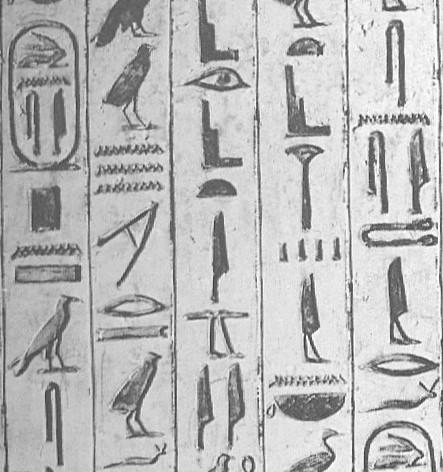

In [4]:
im = cv2.imread("/content/drive/MyDrive/Mathestudium/Data Science MSc/Masterarbeit/Datensätze/Testdaten_Segmentierer/Ausschnitt_GOD_Gemert_UnasPyramide (10).jpg")
cv2_imshow(im)

Prädiktor auf Basis des vortrainierten Modells

In [6]:
# device = torch.device("cpu")
cfg = get_cfg()

cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.2  # set threshold for this model
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.MODEL.DEVICE = "cpu"  # Explicitly set the device to CPU
predictor = DefaultPredictor(cfg)
outputs = predictor(im)

[03/28 15:40:55 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


model_final_f10217.pkl: 178MB [00:01, 129MB/s]                           
/usr/local/lib/python3.11/dist-packages/torch/functional.py:539: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /pytorch/aten/src/ATen/native/TensorShape.cpp:3637.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Vorhersage

In [7]:
# look at the outputs. See https://detectron2.readthedocs.io/tutorials/models.html#model-output-format for specification
print(outputs["instances"].pred_classes)
print(outputs["instances"].pred_boxes)

tensor([14, 14,  0, 23,  0, 30, 36])
Boxes(tensor([[101.5730,  40.4770, 155.1458, 129.7381],
        [  8.9362, 295.1079,  82.0261, 376.5486],
        [300.5413, 272.7604, 326.7546, 363.0104],
        [  7.5068, 291.9821,  84.0086, 376.5783],
        [112.5080, 351.5320, 161.6673, 439.1156],
        [ 99.5687, 440.4577, 168.3964, 467.6204],
        [116.0806, 432.7664, 167.4267, 465.7028]]))


Visualisierung

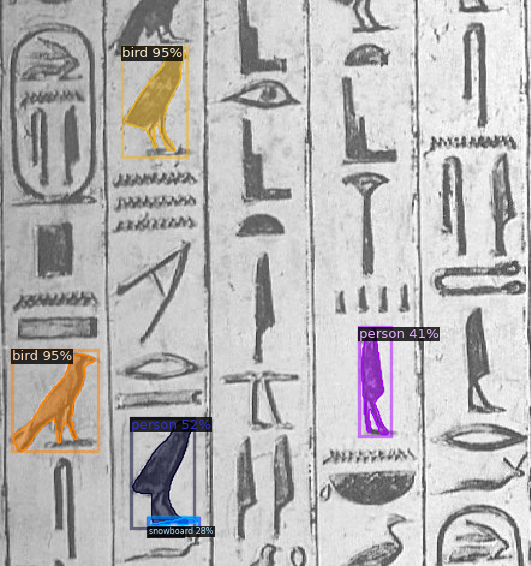

In [ ]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

Ausgabe der gefundenen Hieroglyphen in Boxen:

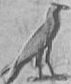

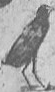

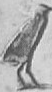

In [ ]:
# Iteriere durch die erkannten Instanzen und schneide die Bereiche aus
for i in range(len(outputs["instances"])):
    bbox = outputs["instances"].pred_boxes[i].tensor.cpu().numpy()[0]
    x1, y1, x2, y2 = map(int, bbox)  # Extrahiere die Koordinaten des Begrenzungsrahmens

    # Schneide den Bereich aus dem Originalbild aus
    cropped_image = im[y1:y2, x1:x2]

    # Speichere oder zeige das ausgeschnittene Bild an
    cv2.imwrite(f"cropped_image_{i}.jpg", cropped_image)  # Speichern
    cv2_imshow(cropped_image)  # Anzeigen
    print()

# Training auf benutzerdefiniertem Datensatz

Der eigens erstellte Trainingsdatensatz mit den Annotationen aus dem VGG Image Annotator wird für das Transfer Learning des vortrainierten COCO-Modells verwendet. Es gibt zunächst nur die Klasse "Hieroglyph".


## Vorbereitung

Registrierung des Datensatzes


In [8]:
def get_glyphs_dicts(img_dir):
    json_file = os.path.join(img_dir, "Annotationen.json")
    with open(json_file, encoding='utf-8') as f:
        imgs_anns = json.load(f)

    dataset_dicts = []
    for idx, v in enumerate(imgs_anns.values()):
        record = {}

        filename = os.path.join(img_dir, v["filename"])
        height, width = cv2.imread(filename).shape[:2]

        record["file_name"] = filename
        record["image_id"] = idx
        record["height"] = height
        record["width"] = width

        annos = v["regions"]
        objs = []
        for anno in annos:
            anno = anno["shape_attributes"]
            if anno["name"] == "rect":  # rectangular regions
                  x = anno["x"]
                  y = anno["y"]
                  width = anno["width"]
                  height = anno["height"]
                  # Berechne die Eckpunkte der Bounding Box
                  px = [x, x + width, x + width, x]
                  py = [y, y, y + height, y + height]
            else:  # polygonal regions
                  px = anno["all_points_x"]
                  py = anno["all_points_y"]

            poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]
            obj = {
                "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                "category_id": 0,
            }
            objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

In [ ]:
for d in ["Trainingsdaten_Segmentierer", "Testdaten_Segmentierer"]:
    path = "/content/drive/MyDrive/Mathestudium/Data Science MSc/Masterarbeit/Datensätze/"
    DatasetCatalog.register("glyphs_" + d, lambda d=d: get_glyphs_dicts(path + d))
    MetadataCatalog.get("glyphs_" + d).set(thing_classes=["Hieroglyph"])
glyphs_metadata = MetadataCatalog.get("glyphs_Trainingsdaten_Segmentierer")

Visualisierung der Annotationen



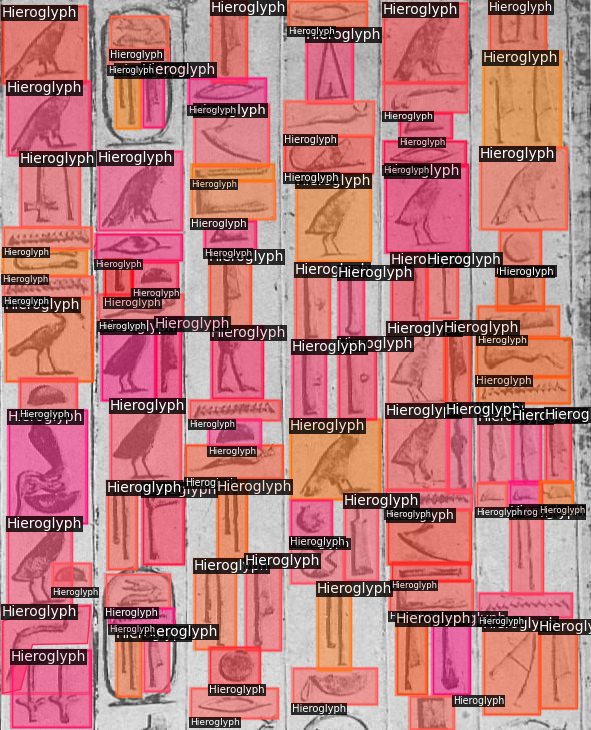

In [ ]:


dataset_dicts = get_glyphs_dicts(path + "Trainingsdaten_Segmentierer")
for d in random.sample(dataset_dicts, 1):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=glyphs_metadata, instance_mode=ColorMode.SEGMENTATION) # Set instance mode
    # Customize the color palette if needed:
    visualizer.metadata.thing_colors = [(255, 0, 0)]  # Red color for all instances
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

Analyse der Klassenverteilung

In [ ]:
# @title
def output_class_distribution_to_csv(dataset_name, output_dir):
    """Berechnet die Klassenverteilung eines Datensatzes, gibt sie in eine CSV-Datei aus und printet die Gesamtzahl der Elemente."""
    dataset_dicts = DatasetCatalog.get(dataset_name)
    metadata = MetadataCatalog.get(dataset_name)

    # Calculate class distribution
    class_distribution = collections.Counter([ann["category_id"] for image_dict in dataset_dicts for ann in image_dict["annotations"]])

    # Calculate the total number of elements
    total_elements = sum(class_distribution.values())

    # Erstelle den Ausgabepfad für die CSV-Datei
    os.makedirs(output_dir, exist_ok=True)
    output_file = os.path.join(output_dir, f"{dataset_name}_class_distribution.csv")

    # Schreibe die Daten in die CSV-Datei
    with open(output_file, 'w', newline='', encoding='utf-8') as csvfile:
        writer = csv.writer(csvfile)
        writer.writerow(["Klasse", "Anzahl"])  # Schreibe die Header-Zeile

        for category_id, count in class_distribution.items():
            category_name = metadata.thing_classes[category_id]
            writer.writerow([category_name, count])

    print(f"CSV-Datei für {dataset_name} erstellt: {output_file}")
    print(f"Gesamtzahl der Elemente im Datensatz {dataset_name}: {total_elements}")


# Registrierte Datensatznamen
dataset_names = ["glyphs_Trainingsdaten_Segmentierer", "glyphs_Testdaten_Segmentierer"]
output_directory = "/content" # Ordner für die CSVs

# Analysiere jeden Datensatz und erstelle die CSV-Datei
for dataset_name in dataset_names:
  output_class_distribution_to_csv(dataset_name, output_directory)

## Training!

Finetuning eines COCO-pretrained R50-FPN Mask R-CNN Modells.


In [ ]:
cfg = get_cfg()
#Mask Regression zur Ermittlung der genauen Kontur
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
#Bounding Box Regression zur Ermittlung einer rechteckigen Bounding Box
#cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("glyphs_Trainingsdaten_Segmentierer",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.001  # pick a good LR
cfg.SOLVER.MAX_ITER = 5000    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
#cfg.SOLVER.GAMMA = 0.1
#cfg.SOLVER.STEPS = (2000,) # The iteration number to decrease learning rate by GAMMA.
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   # The "RoIHead batch size". 128 is faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (ballon). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

# Explicitly set the device to CPU
# cfg.MODEL.DEVICE = "cpu"  # This line ensures the model runs on the CPU

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=True)
trainer.train()

[02/28 16:41:32 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.11/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

[02/28 16:41:36 d2.engine.hooks]: Loading scheduler from state_dict ...
[02/28 16:41:36 d2.engine.train_loop]: Starting training from iteration 4000
[02/28 16:41:50 d2.utils.events]:  eta: 0:10:53  iter: 4019  total_loss: 0.3469  loss_cls: 0.01947  loss_box_reg: 0.1438  loss_mask: 0.09958  loss_rpn_cls: 0.003841  loss_rpn_loc: 0.0799    time: 0.6687  last_time: 0.6392  data_time: 0.0436  last_data_time: 0.0218   lr: 0.01  max_mem: 4776M
[02/28 16:42:05 d2.utils.events]:  eta: 0:11:09  iter: 4039  total_loss: 0.3623  loss_cls: 0.03146  loss_box_reg: 0.1464  loss_mask: 0.09994  loss_rpn_cls: 0.004048  loss_rpn_loc: 0.08574    time: 0.6925  last_time: 0.6565  data_time: 0.0119  last_data_time: 0.0013   lr: 0.01  max_mem: 4776M
[02/28 16:42:20 d2.utils.events]:  eta: 0:11:06  iter: 4059  total_loss: 0.3564  loss_cls: 0.01888  loss_box_reg: 0.142  loss_mask: 0.1075  loss_rpn_cls: 0.003676  loss_rpn_loc: 0.0773    time: 0.7112  last_time: 0.9213  data_time: 0.0167  last_data_time: 0.0263   l

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 10678), started 0:56:07 ago. (Use '!kill 10678' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
# Definiere den Speicherpfad für dein Modell
output_dir = "/content/drive/MyDrive/detectron2_models"  # Passe den Pfad an deine Bedürfnisse an
os.makedirs(output_dir, exist_ok=True)  # Erstelle das Verzeichnis, falls es noch nicht existiert
model_path = os.path.join(output_dir, "segm_5000_512_01_001.pth")  # Definiere den Dateinamen

# Speichere das Modell mit torch.save()
torch.save(trainer.model.state_dict(), model_path)

## Evaluation des trainierten Modells
Visuelle Evaluierung und automatische Evaluierung auf dem Testdatensatz



Prädiktor direkt nach dem Training erstellen:

In [ ]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor

model_path = "/content/drive/MyDrive/detectron2_models/segm_5000_512_01_001.pth"  # Ersetze "dein_modell.pth" durch den tatsächlichen Dateinamen

cfg = get_cfg()
# Lade die Konfiguration, die du beim Training verwendet hast (z. B. aus model_zoo)
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
#cfg.DATASETS.TRAIN = ("glyphs_Trainingsdaten_Segmentierer",)
#cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 2  # This is the real "batch size" commonly known to deep learning people
#cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
#cfg.SOLVER.MAX_ITER = 3000    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
#cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   # The "RoIHead batch size". 128 is faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (ballon).
cfg.MODEL.WEIGHTS = model_path  # Setze den Pfad zu deinem gespeicherten Modell
cfg.MODEL.DEVICE = "cpu"  # Füge diese Zeile hinzu
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
#cfg.MODEL.ROI_HEADS.NMS_THRESH_TEST = 0.5
cfg.TEST.DETECTIONS_PER_IMAGE = 1000 # Maximum number of detections to return per image during inference (100 is
# based on the limit established for the COCO dataset).
cfg.MODEL.RPN.PRE_NMS_TOPK_TEST = 5000  #Anzahl der Region Proposals vor NMS
cfg.MODEL.RPN.POST_NMS_TOPK_TEST = 1000  #Anzahl der Region Proposals nach NMS
predictor = DefaultPredictor(cfg)  # Erstelle den Predictor

[03/01 09:20:11 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/detectron2_models/segm_5000_512_01_001.pth ...


/usr/local/lib/python3.11/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

In [ ]:
# @title
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.3   # set a custom testing threshold
cfg.MODEL.ROI_HEADS.NMS_THRESH_TEST = 0.5
predictor = DefaultPredictor(cfg)

[02/27 22:16:53 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


/usr/local/lib/python3.11/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

Visualisierung der Vorhersagen durch das Modell an fest- und zufällig gewählten Beispielen

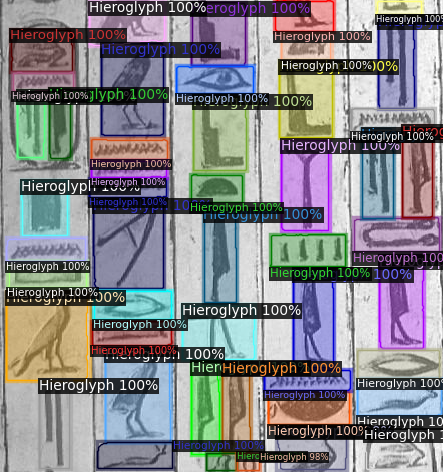

In [ ]:
from detectron2.utils.visualizer import ColorMode

dataset_dicts = get_glyphs_dicts(path + "Testdaten_Segmentierer")
#dataset_dicts = get_glyphs_dicts(path + "Trainingsdaten_Segmentierer")
#target_image_path = "/content/drive/MyDrive/Mathestudium/Data Science MSc/Masterarbeit/Datensätze/Testdaten_Segmentierer/Ausschnitt_GMD_ME_SteleQemnen.jpg"
target_image_path = "/content/drive/MyDrive/Mathestudium/Data Science MSc/Masterarbeit/Datensätze/Testdaten_Segmentierer/Ausschnitt_GOD_Gemert_UnasPyramide (10).jpg"
#target_image_path = "/content/drive/MyDrive/Mathestudium/Data Science MSc/Masterarbeit/Datensätze/Trainingsdaten_Segmentierer/Ausschnitt_GMD_MET_ReliefNebhepetreMentuhotep2.jpg"
#target_image_path = "/content/drive/MyDrive/Mathestudium/Data Science MSc/Masterarbeit/Datensätze/Testdaten_Segmentierer/Ausschnitt_HS_LIT_HeinrichBrugschAltägyptischeInschriften_S253.jpg"
#target_image_path = "/content/drive/MyDrive/Mathestudium/Data Science MSc/Masterarbeit/Datensätze/Testdaten_Segmentierer/KontrastA_egyptianTexts23.jpg"

# Verwende eine List Comprehension und next(), um das Dictionary zu finden
try:
    d = next(d for d in dataset_dicts if d["file_name"] == target_image_path)
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(img[:, :, ::-1],
                   metadata=glyphs_metadata,
                   scale=1,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu")
    )
    cv2_imshow(out.get_image()[:, :, ::-1])

except StopIteration:
    print(f"Error: Image with path {target_image_path} not found in dataset.")

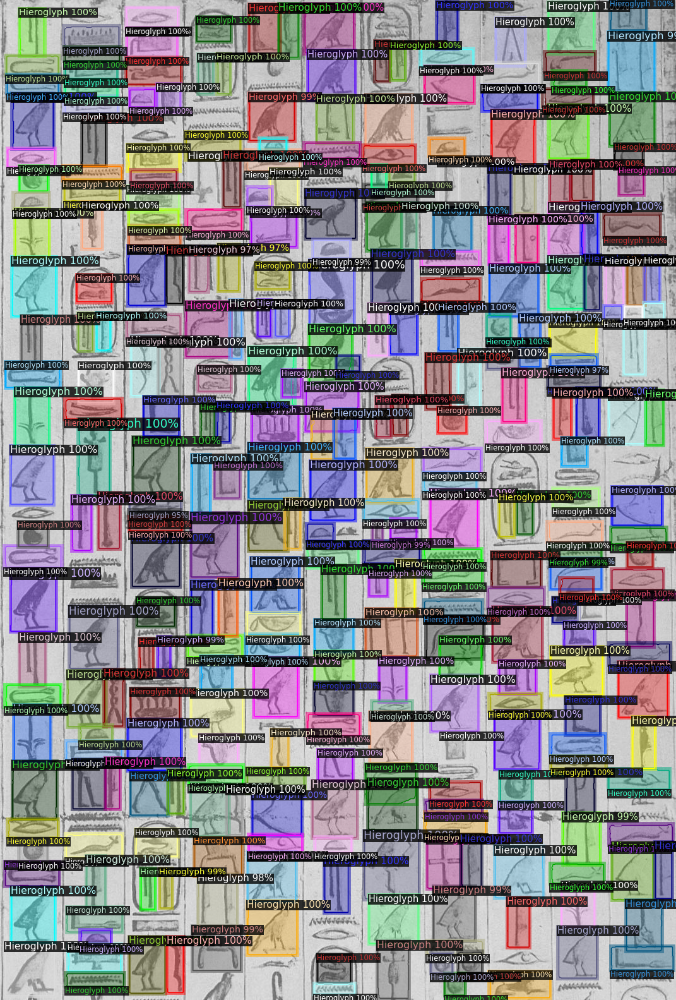

In [ ]:
from detectron2.utils.visualizer import ColorMode

dataset_dicts = get_glyphs_dicts(path + "Testdaten_Segmentierer")
# Get the dataset dicts for your registered dataset
#test_pfad = "/content/drive/MyDrive/Mathestudium/Data Science MSc/Masterarbeit/Datensätze/Testdaten_Segmentierer"

# Get or create the metadata for visualization
#glyphs_metadata = MetadataCatalog.get("glyphs_Testdaten_Segmentierer") # Benutze den registrierten Namen

# Get a list of image file paths in the directory
#image_files = [os.path.join(test_pfad, f) for f in os.listdir(test_pfad) if os.path.isfile(os.path.join(test_pfad, f))]

#for file_path in random.sample(image_files, 1):
#    im = cv2.imread(file_path)
for d in random.sample(dataset_dicts, 1):
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(img[:, :, ::-1],
                   metadata=glyphs_metadata,
                   scale=1,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

We can also evaluate its performance using AP metric implemented in COCO API.
This gives an AP of ~55. Not bad!

Threshold: 0.3

Analyseergebnis bei 11 Trainingsbildern und **300 Iterationen**, Batchsize = 128, LR = 0.00025 beim Training mit **Mask-Regression**:

|   AP   |  AP50  |  AP75  |  APs   |  APm   |  APl  |
|:------:|:------:|:------:|:------:|:------:|:-----:|
| 54.781 | 90.263 | 58.213 | 45.939 | 57.761 |  nan  |

Analyseergebnis bei 11 Trainingsbildern und **500 Iterationen**, Batchsize = 128, LR = 0.00025 beim Training mit **Mask-Regression**:

|   AP   |  AP50  |  AP75  |  APs   |  APm   |  APl  |
|:------:|:------:|:------:|:------:|:------:|:-----:|
| 59.696 | 92.066 | 73.133 | 51.149 | 62.014 |  nan  |

Analyseergebnis bei 11 Trainingsbildern und **300 Iterationen**, Batchsize = 128, LR = 0.00025 beim Training mit **Bounding Box Regression (Faster R-CNN)**:

|   AP   |  AP50  |  AP75  |  APs   |  APm   |  APl  |
|:------:|:------:|:------:|:------:|:------:|:-----:|
| 54.181 | 90.644 | 55.729 | 43.531 | 58.138 |  nan  |

Analyseergebnis bei 11 Trainingsbildern und **500 Iterationen**, Batchsize = 128, LR = 0.00025 beim Training mit **Bounding Box Regression (Faster R-CNN)**:

|   AP   |  AP50  |  AP75  |  APs   |  APm   |  APl  |
|:------:|:------:|:------:|:------:|:------:|:-----:|
| 59.742 | 91.838 | 67.847 | 47.705 | 63.057 |  nan  |

Analyseergebnis bei 30 Trainingsbildern und **500 Iterationen**, Batchsize = 128, LR = 0.00025 beim Training mit **Mask-Regression**:

|   AP   |  AP50  |  AP75  |  APs   |  APm   |  APl   |
|:------:|:------:|:------:|:------:|:------:|:------:|
| 53.547 | 83.335 | 67.228 | 37.942 | 56.569 | 56.852 |

Analyseergebnis bei 30 Trainingsbildern und **1000 Iterationen**, Batchsize = 128, LR = 0.00025 beim Training mit **Mask-Regression**:

|   AP   |  AP50  |  AP75  |  APs   |  APm   |  APl   |
|:------:|:------:|:------:|:------:|:------:|:------:|
| 57.816 | 87.943 | 76.233 | 48.352 | 60.030 | 59.737 |

Analyseergebnis bei 30 Trainingsbildern und **2000 Iterationen**, Batchsize = 128, LR = 0.00025 beim Training mit **Mask-Regression**:

|   AP   |  AP50  |  AP75  |  APs   |  APm   |  APl   |
|:------:|:------:|:------:|:------:|:------:|:------:|
| 58.253 | 90.292 | 69.229 | 48.838 | 60.425 | 61.621 |

Analyseergebnis bei 30 Trainingsbildern und **1000 Iterationen**, Batchsize = 256, LR = 0.00025 beim Training mit **Mask-Regression**:

|   AP   |  AP50  |  AP75  |  APs   |  APm   |  APl   |
|:------:|:------:|:------:|:------:|:------:|:------:|
| 56.967 | 86.067 | 70.630 | 46.460 | 60.076 | 57.686 |

Analyseergebnis bei 30 Trainingsbildern und **1000 Iterationen**, Batchsize = 64, LR = 0.00025 beim Training mit **Mask-Regression**:

|   AP   |  AP50  |  AP75  |  APs   |  APm   |  APl   |
|:------:|:------:|:------:|:------:|:------:|:------:|
| 57.011 | 87.305 | 68.091 | 45.158 | 60.263 | 58.709 |

--> Batchsize 128 ist ok!

Analyseergebnis bei 30 Trainingsbildern und **1000 Iterationen**, Batchsize = 128, LR = 0.001 beim Training mit **Mask-Regression**:

|   AP   |  AP50  |  AP75  |  APs   |  APm   |  APl   |
|:------:|:------:|:------:|:------:|:------:|:------:|
| 57.112 | 91.021 | 67.775 | 47.353 | 57.569 | 63.032 |

Analyseergebnis bei 30 Trainingsbildern und **4000 Iterationen**, Batchsize = 128, LR = 0.00025 beim Training mit **Mask-Regression** (loss bis ca. 0.46):

|   AP   |  AP50  |  AP75  |  APs   |  APm   |  APl   |
|:------:|:------:|:------:|:------:|:------:|:------:|
| 60.914 | 90.632 | 75.683 | 52.400 | 62.766 | 63.011 |

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("glyphs_Testdaten_Segmentierer", output_dir="./output", max_dets_per_image=1000)
val_loader = build_detection_test_loader(cfg, "glyphs_Testdaten_Segmentierer")
print(inference_on_dataset(predictor.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

[03/01 09:20:49 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
[03/01 09:20:49 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[03/01 09:20:49 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[03/01 09:20:49 d2.data.common]: Serializing 17 elements to byte tensors and concatenating them all ...
[03/01 09:20:49 d2.data.common]: Serialized dataset takes 0.98 MiB
[03/01 09:20:49 d2.evaluation.evaluator]: Start inference on 17 batches
[03/01 09:21:09 d2.evaluation.evaluator]: Inference done 1/17. Dataloading: 0.2441 s/iter. Inference: 19.6925 s/iter. Eval: 0.0983 s/iter. Total: 20.0361 s/iter. ETA=0:05:20
[03/01 09:21:17 d2.evaluation.evaluator]: Inference done 2/17. Dataloading: 0.1231 s/iter. Inference: 13.5182 s/iter. Eval: 0.0538 s/iter. Total: 13.6969 s/iter. ETA=0:03:25

Evaluation results for bbox (Bounding Box Evaluation):

  Was wird bewertet? Diese Auswertung konzentriert sich auf die Leistung des Modells bei der Vorhersage von Bounding Boxes, die die Position und Größe der Objekte im Bild beschreiben. Es werden also Rechtecke um die Objekte bewertet.
  
Evaluation results for segm (Segmentation Mask Evaluation):

  Was wird bewertet? Diese Auswertung bewertet die Leistung des Modells bei der Vorhersage von Pixelmasken, die die genaue Form der Objekte im Bild beschreiben. Hier werden also die pixelgenauen Umrisse der Objekte bewertet.

Laden und Testen des Modells

In [ ]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
from detectron2 import model_zoo
import os
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

model_path = "/content/drive/MyDrive/detectron2_models/segm_3000_512_00025.pth"

# 1. Konfiguration laden und anpassen
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))

# Alle Parameter, die in der Konfiguration angepasst werden, müssen vor dem Predictor/Loader stehen
cfg.MODEL.WEIGHTS = model_path
cfg.MODEL.DEVICE = "cpu"
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.2
cfg.TEST.DETECTIONS_PER_IMAGE = 1000
#cfg.MODEL.RPN.PRE_NMS_TOPK_TEST = 1500
#cfg.MODEL.RPN.POST_NMS_TOPK_TEST = 1000
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1

# 2. DefaultPredictor erstellen
predictor = DefaultPredictor(cfg)

# 3. Testdaten laden und Evaluator instanziieren
evaluator = COCOEvaluator("glyphs_Testdaten_Segmentierer", output_dir="./output", max_dets_per_image=1000)
val_loader = build_detection_test_loader(cfg, "glyphs_Testdaten_Segmentierer")


# 4. Inferenz und Evaluation durchführen
print(inference_on_dataset(predictor.model, val_loader, evaluator))

[02/28 13:25:26 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/detectron2_models/segm_3000_512_00025.pth ...


/usr/local/lib/python3.11/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

[02/28 13:25:30 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
[02/28 13:25:31 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[02/28 13:25:31 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[02/28 13:25:31 d2.data.common]: Serializing 17 elements to byte tensors and concatenating them all ...
[02/28 13:25:31 d2.data.common]: Serialized dataset takes 0.98 MiB
[02/28 13:25:31 d2.evaluation.evaluator]: Start inference on 17 batches


/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[02/28 13:25:40 d2.evaluation.evaluator]: Inference done 1/17. Dataloading: 0.3168 s/iter. Inference: 8.7785 s/iter. Eval: 0.0738 s/iter. Total: 9.1700 s/iter. ETA=0:02:26
[02/28 13:25:45 d2.evaluation.evaluator]: Inference done 2/17. Dataloading: 0.1589 s/iter. Inference: 7.0237 s/iter. Eval: 0.0401 s/iter. Total: 7.2238 s/iter. ETA=0:01:48
[02/28 13:25:59 d2.evaluation.evaluator]: Inference done 3/17. Dataloading: 0.1066 s/iter. Inference: 8.8014 s/iter. Eval: 0.4512 s/iter. Total: 9.3602 s/iter. ETA=0:02:11
[02/28 13:26:13 d2.evaluation.evaluator]: Inference done 4/17. Dataloading: 0.0804 s/iter. Inference: 10.0810 s/iter. Eval: 0.5389 s/iter. Total: 10.7018 s/iter. ETA=0:02:19
[02/28 13:26:27 d2.evaluation.evaluator]: Inference done 5/17. Dataloading: 0.0646 s/iter. Inference: 10.5388 s/iter. Eval: 0.5891 s/iter. Total: 11.1940 s/iter. ETA=0:02:14
[02/28 13:26:39 d2.evaluation.evaluator]: Inference done 6/17. Dataloading: 0.0000 s/iter. Inference: 12.0433 s/iter. Eval: 0.7645 s/ite

AP (Average Precision):

    Die durchschnittliche Präzision über alle IoU-Schwellenwerte (Intersection over Union) und alle Objektkategorien hinweg. Dies ist eine wichtige Gesamtmetrik, die die Leistung des Modells widerspiegelt.
    Wert: 54.781 Das bedeutet, dass das Modell im Durchschnitt eine Präzision von 54.781% über alle IoU-Schwellenwerte und Kategorien hinweg erreicht.
AP50:

    Die durchschnittliche Präzision bei einem IoU-Schwellenwert von 0.5. Dies misst, wie gut das Modell Objekte mit einer mindestens 50%igen Überlappung mit den Ground-Truth-Boxen erkennt.
    Wert: 90.263 Das bedeutet, dass das Modell bei einem IoU-Schwellenwert von 0.5 eine sehr hohe Präzision von 90.263% erreicht.
Ground-Truth-Boxen:

    In der Objektdetektion und -segmentierung sind Ground-Truth-Boxen manuell annotierte Begrenzungsrahmen, die die tatsächliche Position und Größe der Objekte in einem Bild angeben.
    Sie dienen als Referenz oder "Wahrheit" für die Bewertung der Leistung eines Modells.
    Wenn du beispielsweise ein Modell trainierst, um Hunde auf Bildern zu erkennen, würdest du in den Trainingsdaten für jedes Bild manuell Boxen um alle Hunde zeichnen. Diese Boxen wären die Ground-Truth-Boxen für dieses Bild.
"Dies misst, wie gut das Modell Objekte mit einer mindestens 50%igen Überlappung mit den Ground-Truth-Boxen erkennt":

    Diese Aussage bezieht sich auf die IoU-Metrik (Intersection over Union), die die Überlappung zwischen der vom Modell vorhergesagten Box und der Ground-Truth-Box misst.
    IoU wird berechnet als: Fläche der Überlappung / Fläche der Vereinigung der beiden Boxen.
    Ein IoU-Wert von 0 bedeutet, dass es keine Überlappung zwischen den Boxen gibt, während ein Wert von 1 eine perfekte Überlappung bedeutet.Die Aussage "mindestens 50%ige Überlappung" bedeutet, dass eine Vorhersage des Modells nur dann als korrekt gewertet wird, wenn die IoU zwischen der vorhergesagten Box und der entsprechenden Ground-Truth-Box mindestens 0.5 beträgt.

  Zusammenfassend:

    Ground-Truth-Boxen sind manuell erstellte Begrenzungsrahmen, die die tatsächliche Position von Objekten in einem Bild definieren.
    Die Aussage bezieht sich auf die IoU-Metrik, die die Überlappung zwischen vorhergesagten und Ground-Truth-Boxen misst.
    AP50 misst die Leistung des Modells bei der Erkennung von Objekten, wobei eine Vorhersage als korrekt gewertet wird, wenn sie eine mindestens 50%ige Überlappung (IoU ≥ 0.5) mit der entsprechenden Ground-Truth-Box aufweist.


# Training mit Gardinercode-Labels


Erstellung der Klassenliste

In [ ]:
# Gardinerliste aus CSV-Datei laden
gardiner_list = []
with open('/content/drive/MyDrive/Mathestudium/Data Science MSc/Masterarbeit/Datensätze/unicode_gardinercodes_kurz.csv', 'r', encoding='utf-8') as file:
    reader = csv.reader(file, delimiter=';')
    next(reader)  # Überspringe die Kopfzeile
    for row in reader:
        gardiner_id = int(row[0])  # Gardiner ID aus der ersten Spalte
        gardiner_value = row[2]  # Gardiner Wert aus der zweiten Spalte
        gardiner_list.append((gardiner_id, gardiner_value))  # Füge das Tupel zur Liste hinzu
    gardiner_list.insert(0, (0, 'UD'))

print(gardiner_list)

# Erstelle ein Dictionary zur Zuordnung von gardiner_value zu gardiner_id
gardiner_dict = {gardiner_value: gardiner_id for gardiner_id, gardiner_value in gardiner_list}

# Extrahiere die gardiner_values in eine separate Liste
gardiner_values_list = [value for _, value in gardiner_list]

print(gardiner_values_list)

[(0, 'UD'), (1, 'A1'), (2, 'A2'), (3, 'A3'), (4, 'A4'), (5, 'A5'), (6, 'A5a'), (7, 'A6'), (8, 'A6a'), (9, 'A6b'), (10, 'A7'), (11, 'A8'), (12, 'A9'), (13, 'A10'), (14, 'A11'), (15, 'A12'), (16, 'A13'), (17, 'A14'), (18, 'A14a'), (19, 'A15'), (20, 'A16'), (21, 'A17'), (22, 'A17a'), (23, 'A18'), (24, 'A19'), (25, 'A20'), (26, 'A21'), (27, 'A22'), (28, 'A23'), (29, 'A24'), (30, 'A25'), (31, 'A26'), (32, 'A27'), (33, 'A28'), (34, 'A29'), (35, 'A30'), (36, 'A31'), (37, 'A32'), (38, 'A32a'), (39, 'A33'), (40, 'A34'), (41, 'A35'), (42, 'A36'), (43, 'A37'), (44, 'A38'), (45, 'A39'), (46, 'A40'), (47, 'A40a'), (48, 'A41'), (49, 'A42'), (50, 'A42a'), (51, 'A43'), (52, 'A43a'), (53, 'A44'), (54, 'A45'), (55, 'A45a'), (56, 'A46'), (57, 'A47'), (58, 'A48'), (59, 'A49'), (60, 'A50'), (61, 'A51'), (62, 'A52'), (63, 'A53'), (64, 'A54'), (65, 'A55'), (66, 'A56'), (67, 'A57'), (68, 'A58'), (69, 'A59'), (70, 'A60'), (71, 'A61'), (72, 'A62'), (73, 'A63'), (74, 'A64'), (75, 'A65'), (76, 'A66'), (77, 'A67')

Bearbeitung der Patch-Labels, Registrierung der annotierten Datensätze

In [ ]:
# if your dataset is in COCO format, this cell can be replaced by the following three lines:
# from detectron2.data.datasets import register_coco_instances
# register_coco_instances("my_dataset_train", {}, "json_annotation_train.json", "path/to/image/dir")
# register_coco_instances("my_dataset_val", {}, "json_annotation_val.json", "path/to/image/dir")

from detectron2.structures import BoxMode

def get_glyphs_dicts2(img_dir):
    json_file = os.path.join(img_dir, "Annotationen.json")
    with open(json_file, 'r', encoding='utf-8') as f: # Specify encoding here
        imgs_anns = json.load(f)

    dataset_dicts = []
    for idx, v in enumerate(imgs_anns.values()):
        record = {}

        filename = os.path.join(img_dir, v["filename"])
        height, width = cv2.imread(filename).shape[:2]
        #print(filename)

        record["file_name"] = filename
        record["image_id"] = idx
        record["height"] = height
        record["width"] = width

        annos = v["regions"]
        objs = []
        for anno in annos:
            shape_attr = anno["shape_attributes"]
            if shape_attr["name"] == "rect":  # rectangular regions
                  x = shape_attr["x"]
                  y = shape_attr["y"]
                  width = shape_attr["width"]
                  height = shape_attr["height"]
                  # Berechne die Eckpunkte der Bounding Box
                  px = [x, x + width, x + width, x]
                  py = [y, y, y + height, y + height]
            else:  # polygonal regions
                  px = shape_attr["all_points_x"]
                  py = shape_attr["all_points_y"]

            poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]

            # Get Gardiner value and use it as category_id
            gardiner_value = anno["region_attributes"].get("Gardiner")

            # Set Gardiner value to "UD" if not in the list
            if gardiner_value not in gardiner_values_list:
                gardiner_value = "UD"

            # Hole die zugehörige gardiner_id aus dem Dictionary
            gardiner_id = gardiner_dict.get(gardiner_value)


            obj = {
                "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                "category_id": gardiner_id,  # Use Gardiner value as category_id
            }
            #print(gardiner_id)
            objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

In [ ]:
path = "/content/drive/MyDrive/Mathestudium/Data Science MSc/Masterarbeit/Datensätze/"

dataset_dicts = get_glyphs_dicts2(path + "Trainingsdaten_Segmentierer")

for d in ["Trainingsdaten_Segmentierer", "Testdaten_Segmentierer"]:
    DatasetCatalog.register("glyphs2_" + d, lambda d=d: get_glyphs_dicts2(path + d))
    MetadataCatalog.get("glyphs2_" + d).set(thing_classes=gardiner_values_list)
glyphs_metadata = MetadataCatalog.get("glyphs2_Trainingsdaten_Segmentierer")

In [ ]:
# @title
import csv
import os
import cv2
import json
import numpy as np
import pandas as pd
from detectron2.structures import BoxMode
from detectron2.data import DatasetCatalog, MetadataCatalog
from collections import Counter


def get_glyphs_dicts4(img_dir):
    json_file = os.path.join(img_dir, "Annotationen.json")
    with open(json_file) as f:
        imgs_anns = json.load(f)

    dataset_dicts = []
    gardiner_counts = Counter() # Initialisiere Counter für Gardiner-Werte
    hieroglyph_annotations = [] # List to hold hieroglyph annotations

    for idx, v in enumerate(imgs_anns.values()):
        record = {}

        filename = os.path.join(img_dir, v["filename"])
        #print(f"Checking file: {filename}") # Print the full file path
        if not os.path.exists(filename):
            print(f"Error: File not found: {filename}")
            continue  # Skip to the next file if it doesn't exist

        img = cv2.imread(filename)
        if img is None:
            print(f"Error: Could not read image: {filename}")
            continue # Skip to the next file if it can't be read

        height, width = img.shape[:2]

        record["file_name"] = filename
        record["image_id"] = idx
        record["height"] = height
        record["width"] = width

        annos = v["regions"]
        objs = []
        for anno in annos:
            shape_attr = anno["shape_attributes"]
            if shape_attr["name"] == "rect":  # rectangular regions
                  x = shape_attr["x"]
                  y = shape_attr["y"]
                  width = shape_attr["width"]
                  height = shape_attr["height"]
                  # Berechne die Eckpunkte der Bounding Box
                  px = [x, x + width, x + width, x]
                  py = [y, y, y + height, y + height]
            else:  # polygonal regions
                  px = shape_attr["all_points_x"]
                  py = shape_attr["all_points_y"]

            poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]

            # Get Gardiner value and use it as category_id
            gardiner_value = anno["region_attributes"].get("Gardiner")

            # Use the index of the 'UD' class if gardiner value is not found
            if gardiner_value not in gardiner_values_list:
              gardiner_id = 0
            else:
              gardiner_id = gardiner_dict.get(gardiner_value)
              if gardiner_id is None:
                 gardiner_id = 0

            obj = {
                "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                "category_id": gardiner_id if gardiner_id is not None else 0,  # Use Gardiner value as category_id
            }

            if gardiner_id is None:
                print(f"Fehler: category_id ist None für Datei: {filename}, Bounding Box: {obj['bbox']}, Gardiner Wert: {gardiner_value}")
            objs.append(obj)
            # Zähle den Gardiner-Wert
            if gardiner_value:  # Only count if not none
                gardiner_counts[gardiner_value] += 1
                if gardiner_value == "Hieroglyph":
                     hieroglyph_annotations.append({
                       "filename": filename,
                       "bbox": obj["bbox"]
                     })

        record["annotations"] = objs
        dataset_dicts.append(record)

    # Erstelle DataFrame aus den Zählungen
    df = pd.DataFrame(gardiner_counts.items(), columns=['Gardiner Code', 'Anzahl'])
    df = df.sort_values(by='Gardiner Code') # Sortiere nach Gardiner Code

    return dataset_dicts, df, hieroglyph_annotations #Return dataset_dicts and df


path = "/content/drive/MyDrive/Mathestudium/Data Science MSc/Masterarbeit/Datensätze/"

# Speichere den DataFrame in einer Variable
dataset_dicts, gardiner_df, hieroglyph_annotations = get_glyphs_dicts4(path + "Trainingsdaten_Segmentierer")

# Gib den DataFrame aus
print(gardiner_df)

# Gib die Hieroglyph-Annotationen aus
for annotation in hieroglyph_annotations:
    print(f"Filename: {annotation['filename']}, Bounding Box: {annotation['bbox']}")

# Definiere den Pfad für die CSV-Datei
csv_file_path = "/content/gardiner_counts.csv"

# Exportiere den DataFrame als CSV-Datei
gardiner_df.to_csv(csv_file_path, index=False, encoding='utf-8')
print(f"DataFrame als CSV exportiert nach: {csv_file_path}")


for d in ["Trainingsdaten_Segmentierer", "Testdaten_Segmentierer", "Validierungsdaten_Segmentierer"]:
    DatasetCatalog.register("glyphs11_" + d, lambda d=d: get_glyphs_dicts4(path + d)[0]) # Register only the dataset_dicts
    MetadataCatalog.get("glyphs11_" + d).set(thing_classes=gardiner_values_list)
glyphs_metadata = MetadataCatalog.get("glyphs11_Trainingsdaten_Segmentierer")

    Gardiner Code  Anzahl
118            A1      29
248           A11       1
240           A15       1
214           A17       3
88             A2      14
..            ...     ...
139            Z4      11
197           Z4a       4
72             Z5       4
81             Z7      39
246            Z9       2

[326 rows x 2 columns]
DataFrame als CSV exportiert nach: /content/gardiner_counts.csv


In [ ]:
csv_file_path = "/content/gardiner_counts.csv"
gardiner_df.to_csv(csv_file_path, index=False, encoding='utf-8')

Print eines Beispielbildes samt BB und Labels

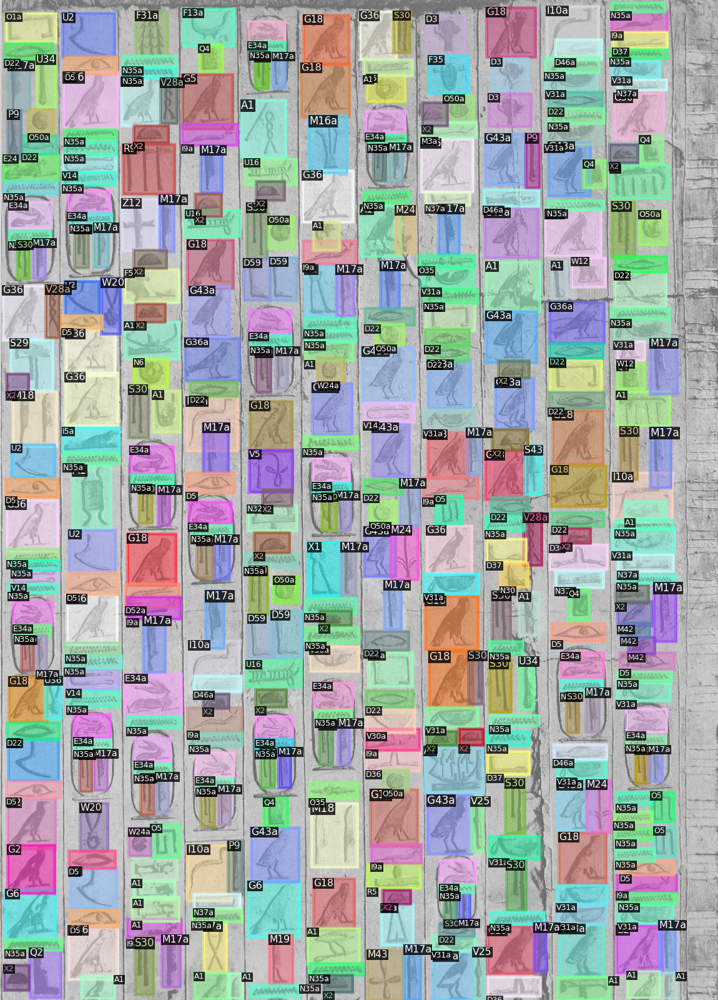

In [ ]:
from detectron2.utils.visualizer import Visualizer, ColorMode

dataset_dicts = get_glyphs_dicts2(path + "Trainingsdaten_Segmentierer")
for d in random.sample(dataset_dicts, 1):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=glyphs_metadata, instance_mode=ColorMode.SEGMENTATION) # Set instance mode

    # Customize the color palette:
    # Instead of accessing thing_colors directly, generate a color for each category:
    num_categories = len(visualizer.metadata.thing_classes)
    colors = [tuple(map(int, np.random.randint(0, 255, size=3))) for _ in range(num_categories)]

    # Assign colors to metadata:
    visualizer.metadata.thing_colors = colors

    # Apply modulo to category_id to ensure it's within the range of thing_colors
    for anno in d["annotations"]:
      if anno["category_id"] is not None:
          if isinstance(anno["category_id"], int):
              anno["category_id"] = anno["category_id"] % len(colors)
          else:
            print(f"Warning: category_id is not an integer for annotation: {anno}, setting to 0")
            anno["category_id"] = 0
      else:
          print(f"Warning: category_id is None for annotation: {anno}, setting to 0")
          anno["category_id"] = 0

    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

Klassenverteilung von Trainings- und Testdatensatz

In [ ]:
import os
import csv
from detectron2.data import MetadataCatalog, DatasetCatalog
import collections

def output_class_distribution_to_csv(dataset_name, output_dir):
    """Berechnet die Klassenverteilung eines Datensatzes, gibt sie in eine CSV-Datei aus und printet die Gesamtzahl der Elemente."""
    dataset_dicts = DatasetCatalog.get(dataset_name)
    metadata = MetadataCatalog.get(dataset_name)

    # Calculate class distribution
    class_distribution = collections.Counter([ann["category_id"] for image_dict in dataset_dicts for ann in image_dict["annotations"]])

    # Calculate the total number of elements
    total_elements = sum(class_distribution.values())

    # Erstelle den Ausgabepfad für die CSV-Datei
    os.makedirs(output_dir, exist_ok=True)
    output_file = os.path.join(output_dir, f"{dataset_name}_class_distribution.csv")

    # Schreibe die Daten in die CSV-Datei
    with open(output_file, 'w', newline='', encoding='utf-8') as csvfile:
        writer = csv.writer(csvfile)
        writer.writerow(["Klasse", "Anzahl"])  # Schreibe die Header-Zeile

        for category_id, count in class_distribution.items():
            category_name = metadata.thing_classes[category_id]
            writer.writerow([category_name, count])

    print(f"CSV-Datei für {dataset_name} erstellt: {output_file}")
    print(f"Gesamtzahl der Elemente im Datensatz {dataset_name}: {total_elements}")


# Registrierte Datensatznamen
dataset_names = ["glyphs2_Trainingsdaten_Segmentierer", "glyphs2_Testdaten_Segmentierer"]
output_directory = "/content/class_distribution_csvs" # Ordner für die CSVs

# Analysiere jeden Datensatz und erstelle die CSV-Datei
for dataset_name in dataset_names:
  output_class_distribution_to_csv(dataset_name, output_directory)

CSV-Datei für glyphs2_Trainingsdaten_Segmentierer erstellt: /content/class_distribution_csvs/glyphs2_Trainingsdaten_Segmentierer_class_distribution.csv
Gesamtzahl der Elemente im Datensatz glyphs2_Trainingsdaten_Segmentierer: 14100
CSV-Datei für glyphs2_Testdaten_Segmentierer erstellt: /content/class_distribution_csvs/glyphs2_Testdaten_Segmentierer_class_distribution.csv
Gesamtzahl der Elemente im Datensatz glyphs2_Testdaten_Segmentierer: 5812


In [ ]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
#Mask Regression zur Ermittlung der genauen Kontur
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
#Bounding Box Regression zur Ermittlung einer rechteckigen Bounding Box
#cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("glyphs2_Trainingsdaten_Segmentierer",)
cfg.DATASETS.TEST = () #Standardmäßig keine Validierung während des Trainings
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # Anzahl der Bilder pro Trainings-Batch
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 1000
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   # Anzahl der RoIs pro Bild für das Training des RoI-Heads
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 969  # NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

# Explicitly set the device to CPU
cfg.MODEL.DEVICE = "cuda"  # This line ensures the model runs on the CPU

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False) # Wiederaufnahme
trainer.train()

[02/26 19:50:49 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[02/26 19:50:50 d2.engine.train_loop]: Starting training from iteration 0
[02/26 19:51:09 d2.utils.events]:  eta: 0:14:49  iter: 19  total_loss: 10.92  loss_cls: 6.944  loss_box_reg: 0.523  loss_mask: 0.693  loss_rpn_cls: 2.492  loss_rpn_loc: 0.2788    time: 0.9111  last_time: 1.0966  data_time: 0.0412  last_data_time: 0.0570   lr: 4.9953e-06  max_mem: 5194M
[02/26 19:51:28 d2.utils.events]:  eta: 0:14:35  iter: 39  total_loss: 9.295  loss_cls: 6.796  loss_box_reg: 0.5257  loss_mask: 0.6928  loss_rpn_cls: 0.9535  loss_rpn_loc: 0.2749    time: 0.9187  last_time: 0.8168  data_time: 0.0206  last_data_time: 0.0012   lr: 9.9902e-06  max_mem: 5194M
[02/26 19:51:44 d2.utils.events]:  eta: 0:13:59  iter: 59  total_loss: 8.424  loss_cls: 6.59  loss_box_reg: 0.5447  loss_mask: 0.6921  loss_rpn_cls: 0.3406  loss_rpn_loc: 0.2517    time: 0.8915  last_time: 0.8159  data_time: 0.0145  last_data_time: 0.0156   lr: 1.4985e-05  max_mem: 5194M
[02/26 19:52:01 d2.utils.events]:  eta: 0:13:10  iter: 79  t



Those are metrics printed out at every iteration of the training loop. The most important ones are the loss values, but below are basic descriptions of them all (eta and iter are self-explanatory I think).

total_loss: This is a weighted sum of the following individual losses calculated during the iteration. By default, the weights are all one.

    loss_cls: Classification loss in the ROI head. Measures the loss for box classification, i.e., how good the model is at labelling a predicted box with the correct class.

    loss_box_reg: Localisation loss in the ROI head. Measures the loss for box localisation (predicted location vs true location).

    loss_rpn_cls: Classification loss in the Region Proposal Network. Measures the "objectness" loss, i.e., how good the RPN is at labelling the anchor boxes as foreground or background.

    loss_rpn_loc: Localisation loss in the Region Proposal Network. Measures the loss for localisation of the predicted regions in the RPN.

    loss_mask: Mask loss in the Mask head. Measures how "correct" the predicted binary masks are.

    For more details on the losses (1) and (2), take a look at the Fast R-CNN paper and the code.

    For more details on the losses (3) and (4), take a look at the Faster R-CNN paper and the code.

    For more details on the loss (5), take a look at the Mask R-CNN paper and the code.

time: Time taken by the iteration.

data_time: Time taken by the dataloader in that iteration.

lr: The learning rate in that iteration.

max_mem: Maximum GPU memory occupied by tensors in bytes.


In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 9540), started 0:00:06 ago. (Use '!kill 9540' to kill it.)

<IPython.core.display.Javascript object>

Export des Modells

In [ ]:
# Definiere den Speicherpfad für dein Modell
output_dir = "/content"  # Passe den Pfad an deine Bedürfnisse an
os.makedirs(output_dir, exist_ok=True)  # Erstelle das Verzeichnis, falls es noch nicht existiert
model_path = os.path.join(output_dir, "all_in_one.pth")  # Definiere den Dateinamen

# Modell speichern
torch.save(trainer.model.state_dict(), model_path)

Laden des Modells

In [ ]:
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor

model_path = "/content/drive/MyDrive/detectron2_models/all_in_one.pth"  # Ersetze "dein_modell.pth" durch den tatsächlichen Dateinamen

cfg = get_cfg()
# Lade die Konfiguration, die du beim Training verwendet hast (z. B. aus model_zoo)
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))

# Parameter
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   # The "RoIHead batch size". 128 is faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 969  # only has one class (ballon).
cfg.MODEL.WEIGHTS = model_path  # Setze den Pfad zu deinem gespeicherten Modell
cfg.MODEL.DEVICE = "cpu"  # Füge diese Zeile hinzu
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.2   # set a custom testing threshold
cfg.TEST.DETECTIONS_PER_IMAGE = 1000
cfg.MODEL.RPN.PRE_NMS_TOPK_TEST = 1500
cfg.MODEL.RPN.POST_NMS_TOPK_TEST = 1000
cfg.MODEL.ROI_HEADS.NMS_THRESH_TEST = 0.2 #Non-Maximum Suppression: Es werden alle anderen Bounding Boxen, die eine erhebliche Überschneidung (IoU über einem vordefinierten Schwellenwert) mit der ausgewählten Box aufweisen, unterdrückt oder entfernt. Das liegt daran, dass diese Boxen wahrscheinlich dasselbe Objekt erkennen.

predictor = DefaultPredictor(cfg)

[02/28 12:51:17 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/detectron2_models/all_in_one.pth ...


/usr/local/lib/python3.11/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

Konfiguration des Modells für die Vorhersage (direkt nach dem Training, d.h. ohne Import)

In [ ]:
# @title
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.2   # set a custom testing threshold
cfg.MODEL.ROI_HEADS.NMS_THRESH_TEST = 0.2 #Non-Maximum Suppression: Es werden alle anderen Bounding Boxen, die eine erhebliche Überschneidung (IoU über einem vordefinierten Schwellenwert) mit der ausgewählten Box aufweisen, unterdrückt oder entfernt. Das liegt daran, dass diese Boxen wahrscheinlich dasselbe Objekt erkennen.
predictor = DefaultPredictor(cfg)

[02/27 13:30:33 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


AssertionError: Checkpoint ./output/model_final.pth not found!

Test des Modells auf einem Beispiel

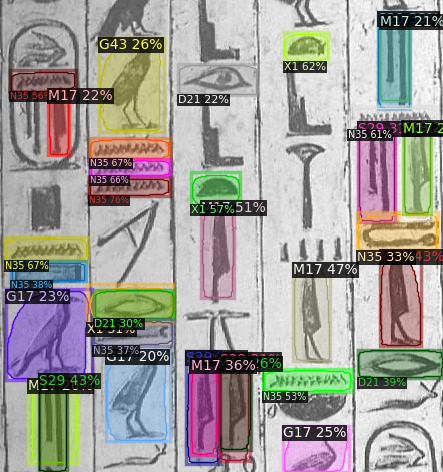

In [ ]:
from detectron2.utils.visualizer import ColorMode

dataset_dicts = get_glyphs_dicts2(path + "Testdaten_Segmentierer")
target_image_path = "/content/drive/MyDrive/Mathestudium/Data Science MSc/Masterarbeit/Datensätze/Testdaten_Segmentierer/Ausschnitt_GOD_Gemert_UnasPyramide (10).jpg"
cv2.destroyAllWindows()
# Verwende eine List Comprehension und next(), um das Dictionary zu finden
try:
    d = next(d for d in dataset_dicts if d["file_name"] == target_image_path)
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(img[:, :, ::-1],
                   metadata=glyphs_metadata,
                   scale=1,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu")
    )
    cv2_imshow(out.get_image()[:, :, ::-1])

except StopIteration:
    print(f"Error: Image with path {target_image_path} not found in dataset.")

Der Prozentsatz, der bei der Vorhersage neben der Klassenbezeichnung an der jeweiligen Box steht, gibt die Konfidenz oder Wahrscheinlichkeit an, mit der das Modell die jeweilige Klasse in dieser Box erkannt hat.

In anderen Worten:
Das Modell ist sich zu X% sicher, dass sich in dieser Box ein Objekt der vorhergesagten Klasse befindet.

Beispiel:

Wenn eine Box mit der Klassenbezeichnung "Gardiner-Zeichen A1" und einem Prozentsatz von 95% angezeigt wird, bedeutet das:

Das Modell hat in dieser Box ein Objekt erkannt.
Es ist zu 95% sicher, dass dieses Objekt das Gardiner-Zeichen A1 ist.

Zusammenhang mit der Schwellenwert:

Du kannst in der Regel einen Schwellenwert (Confidence Threshold) festlegen. Nur Bounding Boxes mit einer Konfidenz, die über diesem Schwellenwert liegt, werden angezeigt. Das hilft dir, die Ergebnisse zu filtern und nur die sichersten Vorhersagen zu berücksichtigen.

Wichtige Hinweise:

Eine hohe Konfidenz bedeutet nicht zwangsläufig, dass die Vorhersage korrekt ist. Das Modell kann sich auch mal irren, selbst wenn es sehr sicher zu sein scheint.
Die Konfidenz ist nur ein Indikator für die Sicherheit des Modells, nicht für die tatsächliche Genauigkeit der Vorhersage.




In [ ]:
import sys
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("glyphs2_Testdaten_Segmentierer", output_dir="./output", max_dets_per_image=1000)
val_loader = build_detection_test_loader(cfg, "glyphs2_Testdaten_Segmentierer")


# Dateipfad für die Ausgabe
output_file_path = "/content/allinone_segmentierer_eval.txt"

# Speichere die ursprüngliche Standardausgabe
original_stdout = sys.stdout

try:
    # Öffne Datei zum Schreiben und leite Standardausgabe um
    with open(output_file_path, 'w') as output_file:
        sys.stdout = output_file

        print(inference_on_dataset(predictor.model, val_loader, evaluator))
        # another equivalent way to evaluate the model is to use `trainer.test`

finally:
    # Stelle die ursprüngliche Standardausgabe wieder her
    sys.stdout = original_stdout

[02/28 12:51:52 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
[02/28 12:51:52 d2.evaluation.coco_evaluation]: Trying to convert 'glyphs2_Testdaten_Segmentierer' to COCO format ...
[02/28 12:51:52 d2.data.datasets.coco]: Converting annotations of dataset 'glyphs2_Testdaten_Segmentierer' to COCO format ...)
[02/28 12:51:53 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[02/28 12:51:55 d2.data.datasets.coco]: Conversion finished, #images: 17, #annotations: 5812
[02/28 12:51:55 d2.data.datasets.coco]: Caching COCO format annotations at './output/glyphs2_Testdaten_Segmentierer_coco_format.json' ...
[02/28 12:51:56 d2.data.build]: Distribution of instances among all 969 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|:----------:|:-------------|
|     UD     | 265          |     A1     | 1            |     A2     | 1 